<div class="alert alert-block alert-info">
<center> <h1> BUSINESS CASE 1: HOTEL CUSTOMER SEGMENTATION </h1> </center> <br>
<center> <h2> Group G </h2> </center> <br>
<center> Business Cases for Data Science </center>
<center> 2022/2023 </center>

**Table of Contents** <br>
* [1. Initial Setup](#setup)
    * [1.1. Import Libraries and Initial Definitions](#importlibraries)
    * [1.2. Import Data](#importdata)
* [2. Data Understanding](#dataunderstanding)
* [3. Data Preparation](#datapreparation)
    * [3.1. Inconsistencies/incoherences](#inconsistencies)
    * [3.2. Data Imputation](#dataimputation)
    * [3.3. Feature Creation](#creation)
    * [3.4. Feature Encoding and Binning](#encoding)
    * [3.5. Company KPI's](#kpis)
    * [3.6. Analysis of our Customers](#analysis_customer)
    * [3.7. Feature Selection](#selection)
    * [3.8. Export](#export)  

<hr>
<a class="anchor" id="setup">
    
# 1. Initial Setup
    
</a>

<a class="anchor" id="importlibraries">

## 1.1. Import Libraries and Initial Definitions

</a>

In [1]:
import pandas as pd
import numpy as np
import pycountry_convert as pc
import matplotlib.pyplot as plt
import seaborn as sns
import math 
import scipy.stats as stats
from ydata_profiling import ProfileReport
from sklearn.preprocessing import OneHotEncoder,MinMaxScaler, StandardScaler, RobustScaler
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from sklearn.ensemble import IsolationForest
from math import ceil
%matplotlib inline

subPlots_Title_fontSize = 12
subPlots_xAxis_fontSize = 10
subPlots_yAxis_fontSize = 10
subPlots_label_fontSize = 10
heatmaps_text_fontSize = 8

plots_Title_fontSize = 14
plots_Title_textColour = 'black'

plots_Legend_fontSize = 12
plots_Legend_textColour = 'black'

plots_barTexts_fontSize = 8

<a class="anchor" id="importlibraries">

## 1.2. Import Data

</a>

In [2]:
ds=pd.read_csv("Case1_HotelCustomerSegmentation.csv",sep=";")
ds.head()

,ID,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
0,1,PRT,52.0,440,0x2C371FD6CE12936774A139FD7430C624F1C4D5109CE6...,0x434FD3D59469C73AFEA087017FAF8CA2296493AEABDE...,59,292.0,82.3,1,...,0,0,0,0,0,0,0,0,0,0
1,2,PRT,NaN,1385,0x198CDB98BF37B6E23F9548C56A88B00912D65A9AA0D6...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,61,280.0,53.0,0,...,0,0,0,0,0,0,0,0,0,0
2,3,DEU,32.0,1385,0xDA46E62F66936284DF2844EC4FC542D0DAD780C0EE0C...,0x27F5DF762CCDA622C752CCDA45794923BED9F1B66300...,0,0.0,0.0,0,...,0,0,0,0,0,0,0,0,0,0
3,4,FRA,61.0,1385,0xC45D4CD22C58FDC5FD0F95315F6EFA5A6E7149187D49...,0x8E59572913BB9B1E6CAA12FA2C8B7BF387B1D1F3432E...,93,240.0,60.0,0,...,0,0,0,0,0,0,0,0,0,0
4,5,FRA,52.0,1385,0xD2E3D5BFCA141865669F98D64CDA85AD04DEFF47F8A0...,0x42BDEE0E05A9441C94147076EDDCC47E604DA5447DD4...,0,0.0,0.0,0,...,0,0,0,0,0,0,0,0,0,0


<hr>
<a class="anchor" id="dataunderstanding">
    
# 2. Data Understanding
    
    
</a>

In [3]:
# Checking if 'ID' has any duplicated values
ds['ID'].duplicated().sum()

0

In [4]:
# Setting the index as 'ID'
ds.set_index('ID', inplace = True)
ds.head()

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,
1,PRT,52.0,440,0x2C371FD6CE12936774A139FD7430C624F1C4D5109CE6...,0x434FD3D59469C73AFEA087017FAF8CA2296493AEABDE...,59,292.0,82.3,1,0,...,0,0,0,0,0,0,0,0,0,0
2,PRT,NaN,1385,0x198CDB98BF37B6E23F9548C56A88B00912D65A9AA0D6...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,61,280.0,53.0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,DEU,32.0,1385,0xDA46E62F66936284DF2844EC4FC542D0DAD780C0EE0C...,0x27F5DF762CCDA622C752CCDA45794923BED9F1B66300...,0,0.0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,FRA,61.0,1385,0xC45D4CD22C58FDC5FD0F95315F6EFA5A6E7149187D49...,0x8E59572913BB9B1E6CAA12FA2C8B7BF387B1D1F3432E...,93,240.0,60.0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,FRA,52.0,1385,0xD2E3D5BFCA141865669F98D64CDA85AD04DEFF47F8A0...,0x42BDEE0E05A9441C94147076EDDCC47E604DA5447DD4...,0,0.0,0.0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [5]:
# Generating a profile report to better explore the data
ProfileReport(  
    ds,    
    title='Hotel Data',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": True},
        "kendall": {"calculate": True},
        "phi_k": {"calculate": True},
        "cramers": {"calculate": True},
    },                 
)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
# Number of observations and variables
ds.shape

(111733, 28)

In [7]:
# Variables
ds.columns

Index(['Nationality', 'Age', 'DaysSinceCreation', 'NameHash', 'DocIDHash',
       'AverageLeadTime', 'LodgingRevenue', 'OtherRevenue', 'BookingsCanceled',
       'BookingsNoShowed', 'BookingsCheckedIn', 'PersonsNights', 'RoomNights',
       'DistributionChannel', 'MarketSegment', 'SRHighFloor', 'SRLowFloor',
       'SRAccessibleRoom', 'SRMediumFloor', 'SRBathtub', 'SRShower', 'SRCrib',
       'SRKingSizeBed', 'SRTwinBed', 'SRNearElevator', 'SRAwayFromElevator',
       'SRNoAlcoholInMiniBar', 'SRQuietRoom'],
      dtype='object')

In [8]:
# There are lines with the same values for every variable
ds.duplicated().sum()

111

In [9]:
ds.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 111733 entries, 1 to 111733
Data columns (total 28 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Nationality           111733 non-null  object 
 1   Age                   107561 non-null  float64
 2   DaysSinceCreation     111733 non-null  int64  
 3   NameHash              111733 non-null  object 
 4   DocIDHash             110732 non-null  object 
 5   AverageLeadTime       111733 non-null  int64  
 6   LodgingRevenue        111733 non-null  float64
 7   OtherRevenue          111733 non-null  float64
 8   BookingsCanceled      111733 non-null  int64  
 9   BookingsNoShowed      111733 non-null  int64  
 10  BookingsCheckedIn     111733 non-null  int64  
 11  PersonsNights         111733 non-null  int64  
 12  RoomNights            111733 non-null  int64  
 13  DistributionChannel   111733 non-null  object 
 14  MarketSegment         111733 non-null  object 
 15  

In [10]:
ds.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Nationality,111733,199,FRA,16516,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Age,107561.0,NaN,NaN,NaN,45.639191,17.244952,-10.0,33.0,47.0,58.0,123.0
DaysSinceCreation,111733.0,NaN,NaN,NaN,595.026599,374.657382,36.0,288.0,522.0,889.0,1385.0
NameHash,111733,107584,0x15A713CE687991691A18F6CDC56ABE24979C73CF5D51...,75,NaN,NaN,NaN,NaN,NaN,NaN,NaN
DocIDHash,110732,103480,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,3032,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AverageLeadTime,111733.0,NaN,NaN,NaN,60.833147,85.11532,-1.0,0.0,21.0,95.0,588.0
LodgingRevenue,111733.0,NaN,NaN,NaN,283.851283,379.131556,0.0,0.0,208.0,393.3,21781.0
OtherRevenue,111733.0,NaN,NaN,NaN,64.682802,123.580715,0.0,0.0,31.0,84.0,8859.25
BookingsCanceled,111733.0,NaN,NaN,NaN,0.002282,0.080631,0.0,0.0,0.0,0.0,15.0
BookingsNoShowed,111733.0,NaN,NaN,NaN,0.0006,0.028217,0.0,0.0,0.0,0.0,3.0


In [11]:
# Organizing the variables
list(ds.columns)
numerical_vars=['Age','AverageLeadTime','LodgingRevenue','OtherRevenue','BookingsCanceled','BookingsNoShowed','BookingsCheckedIn','PersonsNights','RoomNights']
booking_vars=['BookingsCanceled','BookingsNoShowed','BookingsCheckedIn','PersonsNights','RoomNights']
binary_vars=['SRHighFloor','SRLowFloor','SRAccessibleRoom','SRMediumFloor','SRBathtub','SRShower','SRCrib','SRKingSizeBed','SRTwinBed','SRNearElevator','SRAwayFromElevator','SRNoAlcoholInMiniBar','SRQuietRoom']
categorical_vars=['DistributionChannel','MarketSegment']

## Visualizations

### Density Plot

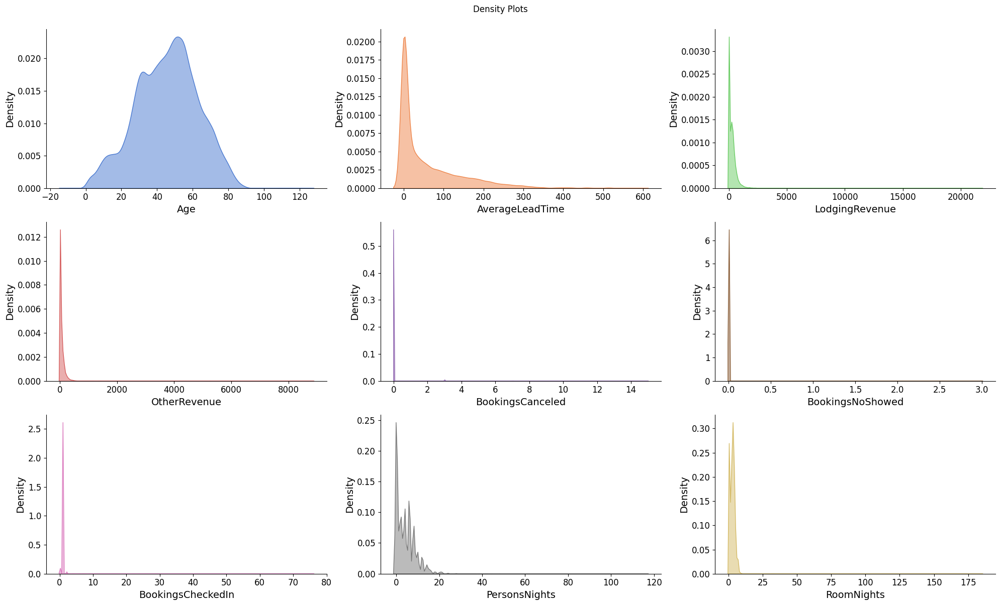

In [12]:
fig, axes = plt.subplots(3, ceil(len(numerical_vars) / 3), figsize=(20, 12))
palette = sns.color_palette('muted', n_colors=len(numerical_vars))

for i, (col, color) in enumerate(zip(numerical_vars, palette)):
    sns.kdeplot(data=ds, x=col, fill=True, ax=axes.flatten()[i], alpha=0.5, color=color)
    axes.flatten()[i].set_xlabel(col, fontsize=14)
    axes.flatten()[i].set_ylabel('Density', fontsize=14)
    axes.flatten()[i].tick_params(axis='both', which='major', labelsize=12)

title = "Density Plots"
plt.suptitle(title, y= 1.0)

sns.despine()
plt.tight_layout()
plt.show()

From the plots above we can conclude we have outliers in almost every feature along with very skewed distributions.

### Pie Chart of Nationalities

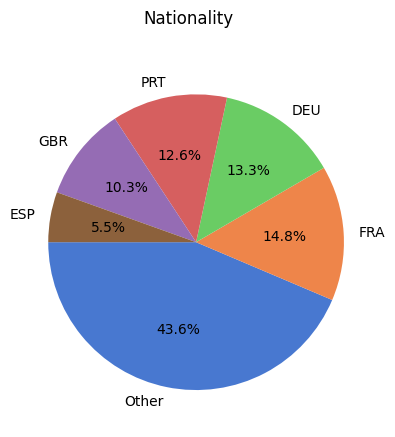

In [13]:
# Make a copy of the DataFrame
ds_copy = ds.copy()

# Calculate the percentage of each nationality
nationality_percentages = ds_copy['Nationality'].value_counts(normalize=True)

# Find the nationalities that represent less than 60% of the total
mask = nationality_percentages.cumsum() > 0.60
nationality_others = nationality_percentages.index[np.where(mask)].tolist()

# Replace the nationalities that represent less than 60% with 'other'
ds_copy['Nationality'] = np.where(ds_copy['Nationality'].isin(nationality_others), 'Other', ds_copy['Nationality'])

palette = sns.color_palette('muted', n_colors=len(ds_copy['Nationality'].unique()))

plt.pie(ds_copy['Nationality'].value_counts(), labels=ds_copy['Nationality'].value_counts().index, autopct='%1.1f%%', startangle=180, colors=palette)

title = "Nationality"
plt.suptitle(title)

plt.show()

Our top five nationalities are Spain, Great Britain, Portugal, Germany and France.

### Pair Plot

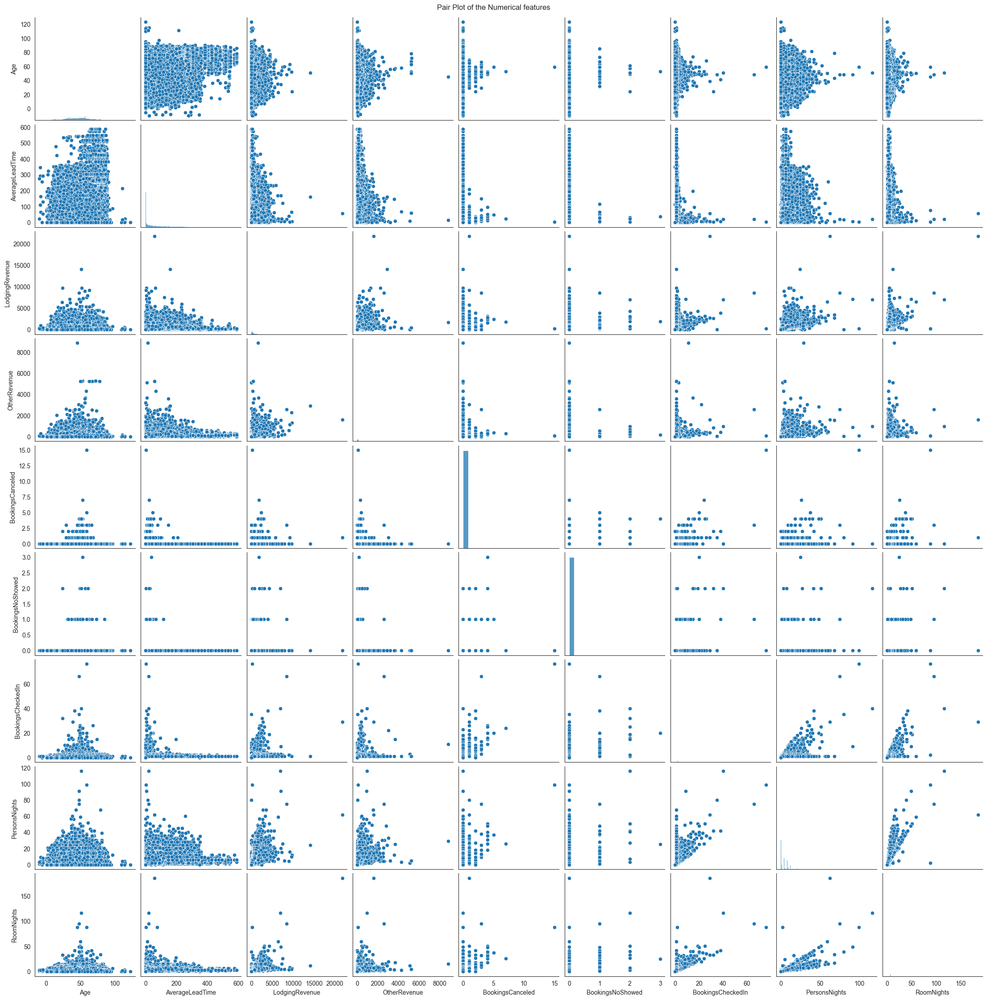

In [14]:
sns.set_style("white")

sns.pairplot(ds[numerical_vars])

title = "Pair Plot of the Numerical features"
plt.suptitle(title, y=1)

plt.show()

### Count Plots

#### Binary Features

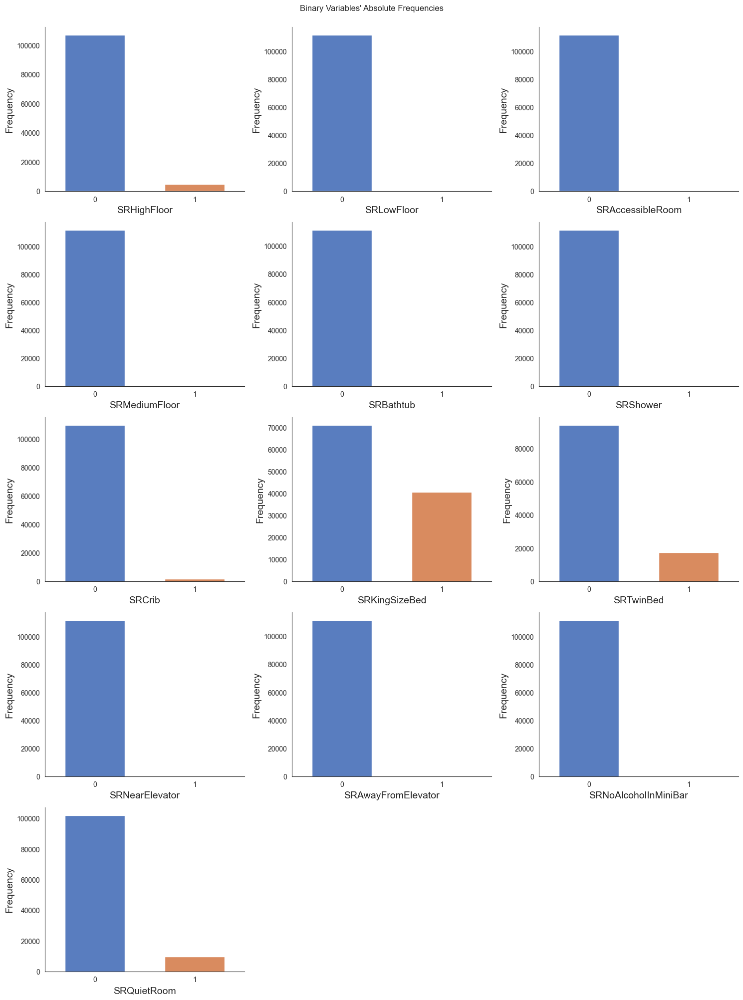

In [15]:
# Create individual axes where each bar plot will be placed
fig, axes = plt.subplots(5, 3, figsize=(15,20))

# Iterate across axes objects and associate each bar plot:
for i, feat in enumerate(binary_vars): 
    ax = axes[i // 3, i % 3]  # Calculate the row and column index for the current feature
    sns.countplot(x=ds[feat], ax=ax, width=0.6, palette='muted')
    ax.set_xlabel(feat, fontsize=14)
    ax.set_ylabel('Frequency', fontsize=14)

# Remove the last two plots in the last row
axes[-1, -1].remove()
axes[-1, -2].remove()

title = "Binary Variables' Absolute Frequencies"
plt.suptitle(title, y= 1.0)

sns.despine()
plt.tight_layout()
plt.show()

#### Categorical Features

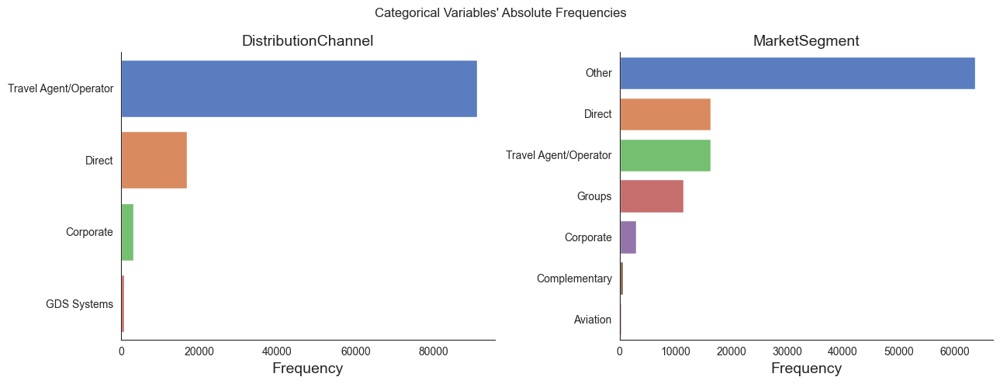

In [16]:
# Prepare figure. Create individual axes where each bar plot will be placed
fig, axes = plt.subplots(1, len(categorical_vars), figsize=(13, 5))

# Iterate across axes objects and associate each bar plot
for ax, feat in zip(axes.flatten(), categorical_vars):
    feat_sorted = ds[feat].value_counts().sort_values(ascending = False) # Sort the values in ascending order
    sns.barplot(y=feat_sorted.index, x=feat_sorted.values, ax=ax, palette='muted')
    ax.set_title(feat, fontsize=14)
    ax.set_xlabel('Frequency', fontsize=14)

title = "Categorical Variables' Absolute Frequencies"
plt.suptitle(title)

sns.despine()
plt.tight_layout()
plt.show()

### Box Plots

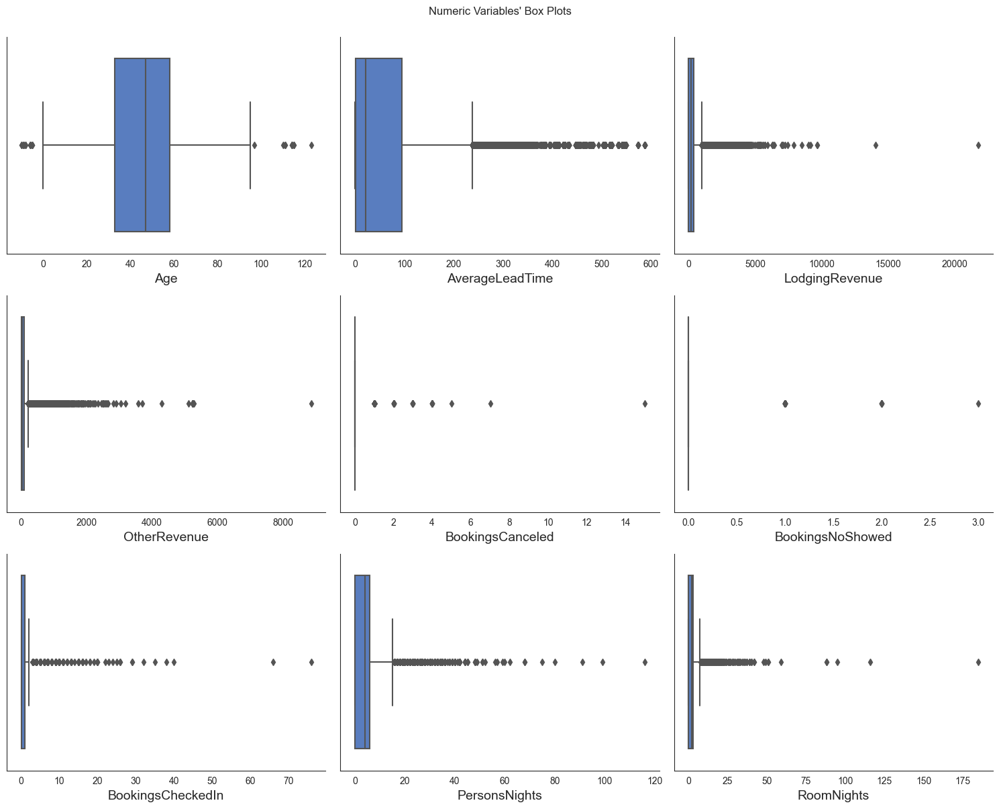

In [17]:
# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(3, 3, figsize=(15,12))

# Iterate across axes objects and associate each box plot
for ax, feat in zip(axes.flatten(), numerical_vars): 
    sns.boxplot(x=ds[feat], ax=ax, palette='muted')
    ax.set_xlabel(feat, fontsize=14)
    
title = "Numeric Variables' Box Plots"
plt.suptitle(title, y = 1.0)

sns.despine()
plt.tight_layout()
plt.show()

<hr>
<a class="anchor" id="datapreparation">
    
# 3. Data Preparation
    
    
</a>

In [18]:
# Saving the original dataset
original_ds=ds.copy()

### Dropping duplicates

In [19]:
# Dropping duplicates
ds.drop_duplicates(inplace = True)

# How many observations we have now
ds.shape[0]

111622

In [20]:
print('Percentage of data kept after removing duplicates:', np.round(ds.shape[0] / original_ds.shape[0], 4))
data_removed1 = np.round(1 - ds.shape[0]/original_ds.shape[0], 4)
print('Percentage of data removed:', data_removed1)

Percentage of data kept after removing duplicates: 0.999
Percentage of data removed: 0.001


<a class="anchor" id="inconsistencies">
    
## 3.1. Inconsistencies/incoherences
    
    
</a>

In [21]:
# Removing lines without BookingsCheckedIn
# The customer retention rate is very low compared to other industries and our focus is on segmenting the customers that have
#actually used our accomodations, therefore we decided to restrict our model to only customer who have actually checked in at
#least once
# https://www.shopify.com/blog/average-customer-retention-rate-by-industry 
ds[ds['BookingsCheckedIn']==0]
ds=ds[ds['BookingsCheckedIn']!=0]

In [22]:
# Dataframe with all the removed lines from the initial dataset
# Removing lines with missing values on DocIDHash
ds[ds['DocIDHash'].isna()]
ds=ds[~ds['DocIDHash'].isna()]

In [23]:
# Merging the duplicate lines in order to get the most information
# Here, we are assuming that we have many profiles for the same client, indicated by the repeating DocIDHash
duplicates=ds[ds.duplicated(subset='DocIDHash',keep=False)].reset_index()
ds.drop_duplicates(subset='DocIDHash',keep=False,inplace=True)

In [24]:
duplicates.groupby('DocIDHash').size().sort_values(ascending=False).head(30)

DocIDHash
0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B934CA495991B7852B855    2893
0xA486FBACF4B4E5537B026743E3FDFE571D716839E758236F42950A61FE6B922B      31
0x2B17E9D2CCEF2EA0FE752EE345BEDFB06741FFC8ECECF45D6BBDBAF9A274FF52      24
0x469CF1F9CF8C790FFA5AD3F484F2938CBEFF6435BCFD734F687EC6D1E968F076      14
0x2A14D03A4827C67E0D39408F103DB417AD496DCE6158F8309E6281185C042003      14
0x3856085146F7BC27BD07BFC4CA1991ED4E65E179D7BDB7DBBA7E32620809C799      12
0x1BF60C4718497A0AB8B46FF00708D3250A484DDA0FDC0248999C782807195BCB      11
0xD2DBD6039916F6DB10C6564D8EB9A9116811435965D7D00E7DA292066B3ECE91      11
0x9220D336F2DDD7B68F5066878889C7637EE28924B249F968F5EC82D895B108A7      11
0xA89022F442F23A6D7486C47C9F968BF35898B36F0EB3531804CA4613FF33DC45      10
0x4C6B6D8800C9C655490B1A6AF049770E20404E0B464C8CD2A3F5A88726F3F823      10
0x951CBCCC0D930B22DF4E9C1B56FE23A240281087B331E53DB453A72EA82CD5B3      10
0x1B16B1DF538BA12DC3F97EDBB85CAA7050D46C148134290FEBA80F8236C83DB9      10
0x8FA8EB6D044E4

In [25]:
duplicates[duplicates['DocIDHash']=='0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B934CA495991B7852B855']

,ID,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
0,2,PRT,NaN,1385,0x198CDB98BF37B6E23F9548C56A88B00912D65A9AA0D6...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,61,280.00,53.0,0,...,0,0,0,0,0,0,0,0,0,0
3,39,PRT,NaN,1385,0xF365E1EC454A18DB722D1DBD8886E027CD4B1234B8A9...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,0,0.00,0.0,0,...,0,0,0,0,0,0,0,0,0,0
4,40,PRT,NaN,1385,0x581FBBDFCA174BB597E096E3A9CBED5E1A9FD615844B...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,0,0.00,0.0,0,...,0,0,0,0,0,0,0,0,0,0
5,56,PRT,NaN,1385,0xD27550946D0D4D9A2C8ACABC25F3EB2E71340638AB58...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,97,213.52,11.5,0,...,0,0,0,0,0,0,0,0,0,0
6,60,PRT,NaN,1385,0xDB729ABCD594E05BE66D31E3E7A89CF84A107E637368...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,1,123.00,12.0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8083,109484,PRT,NaN,54,0xA011EA37E7B0E7AFCF0B891BC8806A9421A8B6D1291D...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,36,708.00,272.5,0,...,0,0,0,0,0,0,0,0,0,0
8091,109890,PRT,NaN,51,0x931C54BCE9C4AF9C876BDE0E1266BDE69C32E5F7D66D...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,75,616.60,72.0,0,...,0,0,0,0,0,1,0,0,0,0
8108,110526,PRT,NaN,47,0x892C54F8D6C0196FFDE05F31F0C52870F681C39B8C07...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,98,119.00,88.0,0,...,0,0,0,0,0,0,0,0,0,0
8117,110672,PRT,NaN,45,0x64A24B438F81CCBF577AFCEE5A290F1A897D71ADCD06...,0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B...,23,59.00,8.0,0,...,0,0,0,0,0,0,0,0,0,0


In [26]:
# Removed the lines corresponding to this DocIDHash because it seems it was used whenever we did not have the DocIDHash of the
#customer (since we have 2893 lines with the same DocIDHash)
duplicates=duplicates[duplicates['DocIDHash']!='0xE3B0C44298FC1C149AFBF4C8996FB92427AE41E4649B934CA495991B7852B855']

In [27]:
# The function was created because .mode() can return empty if nothing occurs at least 2 times
def get_mode_or_random(column):
    mode = column.mode()
    if len(mode) == 0:
        return column.sample().iloc[0] # Return a random value from the column
    else:
        return mode[0] # Return the mode value

# We decided to stick with the first ID that was created. 

# For Nationality, Age, NameHash, Distribution Channel, MarketSegment and all the SR variables we used the function above because 
#they are supposed to have the same values in every duplicate line, thus the mode can help us to distinguish from the errors 
#(in this case, for Nationality there could also be double nationalities and for NameHash the name could not be written in full, 
#but we still think we should preserve the one that appears the most)

# For AverageLeadTime, we decided to use the mean considering it is an average for the bookings of the client.

# For LodgingRevenue, OtherRevenue, BookingsCanceled, BookingsNoShowed, BookingsCheckedIn, PersonsNights and RoomNights 
#we decided to use the sum because if we have many profiles for the same client then some of their bookings was done in one 
#profile and others in another profile.

transform_duplicates={
    'ID': lambda x:x.min(),
    'Nationality': lambda x: get_mode_or_random(x),
    'Age': lambda x: get_mode_or_random(x),
    'DaysSinceCreation': lambda x: x.max(),
    'NameHash': lambda x: get_mode_or_random(x), 
    'AverageLeadTime': lambda x: x.mean(),
    'LodgingRevenue': lambda x: x.sum(),
    'OtherRevenue': lambda x: x.sum(),
    'BookingsCanceled': lambda x: x.sum(),
    'BookingsNoShowed': lambda x: x.sum(),
    'BookingsCheckedIn': lambda x: x.sum(),
    'PersonsNights': lambda x: x.sum(),
    'RoomNights': lambda x: x.sum(),
    'DistributionChannel': lambda x: get_mode_or_random(x),
    'MarketSegment': lambda x: get_mode_or_random(x),
    'SRHighFloor': lambda x: get_mode_or_random(x),
    'SRLowFloor': lambda x:get_mode_or_random(x),
    'SRAccessibleRoom': lambda x:get_mode_or_random(x),
    'SRMediumFloor': lambda x:get_mode_or_random(x),
    'SRBathtub': lambda x:get_mode_or_random(x),
    'SRShower': lambda x:get_mode_or_random(x),
    'SRCrib': lambda x:get_mode_or_random(x),
    'SRKingSizeBed':lambda x:get_mode_or_random(x),
    'SRTwinBed': lambda x:get_mode_or_random(x),
    'SRNearElevator': lambda x:get_mode_or_random(x),
    'SRAwayFromElevator': lambda x:get_mode_or_random(x),
    'SRNoAlcoholInMiniBar': lambda x:get_mode_or_random(x),
    'SRQuietRoom': lambda x:get_mode_or_random(x)}

In [28]:
transformed_duplicates=duplicates.groupby('DocIDHash').agg(transform_duplicates)
transformed_duplicates=transformed_duplicates.reset_index().set_index('ID')
ds=pd.concat([ds,transformed_duplicates])

In [29]:
# Removing lines where we have a higher value of RoomNights when compared to PersonsNights
ds[ds['PersonsNights']<ds['RoomNights']]
ds=ds[ds['PersonsNights']>=ds['RoomNights']]

In [30]:
# Removing lines where BookingsCheckedIn is higher than PersonsNights
ds[ds['BookingsCheckedIn']>ds['PersonsNights']]
ds=ds[ds['BookingsCheckedIn']<=ds['PersonsNights']]

In [31]:
# Removing lines where BookingsCheckedIn is higher than RoomNights
ds[ds['BookingsCheckedIn']>ds['RoomNights']]
ds=ds[ds['BookingsCheckedIn']<=ds['RoomNights']]

In [32]:
print('Percentage of data kept after removing duplicates and inconsistencies/incoherences:', 
      np.round(ds.shape[0] / original_ds.shape[0], 4))
data_removed2 = np.round(1-ds.shape[0]/original_ds.shape[0], 4)
print('Percentage of data removed:', data_removed2)

Percentage of data kept after removing duplicates and inconsistencies/incoherences: 0.6487
Percentage of data removed: 0.3513


In [33]:
# We cannot have negative values for average lead time
ds['AverageLeadTime'].replace(-1,np.nan,inplace=True)

In [34]:
# Even taking into account the days since creation variable, it seems unreasonable to have clients with such ages
ds[ds['Age']>=100].T

ID,3282,44525,45089,87089
Nationality,PRT,DEU,PRT,PRT
Age,115.0,114.0,115.0,111.0
DaysSinceCreation,1305,627,620,244
NameHash,0x02D4575C7FE55631DBE81E8181066109AEFDCA58973F...,0xAA6D4B36828028BE3F09FE5751DE971B7BE4B2BC038E...,0xD906278493442999E6245450B8C306ABB9CA75F39032...,0xCF1B6F56FF2AFF6FA1E6CC35C32AC8F1FA8006071ED0...
DocIDHash,0xEC8ADED0F788BA1D46CEFF00FE180192B783BDA6F184...,0xD37FD9597B00ED4BC4EA2CB864521C48882E30DCA7AE...,0xB207B868D8878FBBB1D449631EFDB684FAFC49AC57AF...,0x6C9FCBE39E3E519B9D2B0AACD3048888B287324F5508...
AverageLeadTime,22.0,7.0,2.0,18.0
LodgingRevenue,79.0,234.0,266.0,210.0
OtherRevenue,25.5,34.5,43.0,52.0
BookingsCanceled,0,0,0,0
BookingsNoShowed,0,0,0,0


In [35]:
# Thus, we are changing the age values to nan
ds['Age']=np.where(ds['Age']>=100,np.nan,ds['Age'])

In [36]:
# We can't have people with negative age
len(ds[ds['Age'] <= 0])

15

In [37]:
# Thus, we are changing the negative age values to nan
ds['Age']=np.where(ds['Age']<=0,np.nan,ds['Age'])

In [38]:
# We need also to verify if we don't have clients younger than their register ('DaysSinceCreation')
ds[(ds['DaysSinceCreation']/365) >= ds['Age']]

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,...,SRMediumFloor,SRBathtub,SRShower,SRCrib,SRKingSizeBed,SRTwinBed,SRNearElevator,SRAwayFromElevator,SRNoAlcoholInMiniBar,SRQuietRoom
ID,,,,,,,,,,,,,,,,,,,,,
4317,ZAF,2.0,1285,0x2C4CCBE682ABD6F2D6A361CD76E55536E0744FA307C7...,0x4A4D3EAF19201D5FEACEA8151926423AF523A86EA01B...,79.0,335.1,79.0,0,0,...,0,0,0,0,1,0,0,0,0,0
11321,BIH,2.0,1172,0x403292A4748035D72FCE687E9E4F093EAF2657F8D590...,0xAD372A162D8BCF66024C290405BAEA5A4184866410E7...,301.0,128.0,54.0,0,0,...,0,0,0,0,0,0,0,0,0,0
25096,ISR,2.0,932,0x9C1F140FF5C9D6D19374C692482768134A844E94390A...,0x2103703C2307B73B332A8E46C134C04A12284155889F...,158.0,166.0,28.0,0,0,...,0,0,0,0,0,1,0,0,0,0
37419,DEU,2.0,751,0x4ED6425187B22A83001DA2F9D993A2B70DA04DA84BC2...,0x71A17891CA74D0CE664BAF2D48A0001133716447BEC2...,7.0,494.0,156.0,0,0,...,0,0,0,0,0,0,0,0,0,0
59278,DEU,1.0,494,0xED83F2B627029CE14CD77092036583E0065A6481FE04...,0x66A5B9D886B7C33D184B935AC3FD2D4AB12087140E62...,193.0,288.0,12.0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [39]:
# Seems reasonable that the age was wrongly recorded, thus we are changing these age values to nan
ds['Age']=np.where((ds['DaysSinceCreation']/365)>=ds['Age'],np.nan,ds['Age'])

<a class="anchor" id="dataimputation">
    
## 3.2. Data Imputation
    
    
</a>

In [40]:
# Count of missing values
data_nan = pd.DataFrame(ds.isna().sum(), columns=['Count'])
data_nan['Percentage (%)'] = round((data_nan['Count'] / len(ds))*100, 2)
data_nan

,Count,Percentage (%)
Nationality,0,0.00
Age,233,0.32
DaysSinceCreation,0,0.00
NameHash,0,0.00
DocIDHash,0,0.00
AverageLeadTime,12,0.02
LodgingRevenue,0,0.00
OtherRevenue,0,0.00
BookingsCanceled,0,0.00
BookingsNoShowed,0,0.00


In [41]:
# Definition of the non metric and metric features
non_metric_features = ['Nationality', 'NameHash', 'DocIDHash', 'DistributionChannel', 'MarketSegment', 'SRHighFloor', 
                       'SRLowFloor', 'SRAccessibleRoom', 'SRMediumFloor', 'SRBathtub', 'SRShower', 'SRCrib', 'SRKingSizeBed', 
                       'SRTwinBed', 'SRNearElevator', 'SRAwayFromElevator', 'SRNoAlcoholInMiniBar', 'SRQuietRoom']
metric_features = ds.columns.drop(non_metric_features).to_list()

In [42]:
# Creating a copy of our data
data_imp = ds.copy()

In [43]:
imputer = IterativeImputer(estimator = LinearRegression(), max_iter = 15, random_state=10)
data_imp[metric_features] = pd.DataFrame(data = imputer.fit_transform(data_imp[metric_features]), 
                        columns = data_imp[metric_features].columns, 
                        index = data_imp[metric_features].index)

In [44]:
data_imp['Age']=data_imp['Age'].round()
data_imp['AverageLeadTime']=data_imp['AverageLeadTime'].round()

In [45]:
# Checking our imputation
data_imp.isna().sum()

Nationality             0
Age                     0
DaysSinceCreation       0
NameHash                0
DocIDHash               0
AverageLeadTime         0
LodgingRevenue          0
OtherRevenue            0
BookingsCanceled        0
BookingsNoShowed        0
BookingsCheckedIn       0
PersonsNights           0
RoomNights              0
DistributionChannel     0
MarketSegment           0
SRHighFloor             0
SRLowFloor              0
SRAccessibleRoom        0
SRMediumFloor           0
SRBathtub               0
SRShower                0
SRCrib                  0
SRKingSizeBed           0
SRTwinBed               0
SRNearElevator          0
SRAwayFromElevator      0
SRNoAlcoholInMiniBar    0
SRQuietRoom             0
dtype: int64

<a class="anchor" id="creation">
    
## 3.3. Feature Creation
    
    
</a>

In [46]:
data_imp['TotalRevenue']=data_imp['LodgingRevenue']+data_imp['OtherRevenue']

In [47]:
# Here, for interpretation purposes, we are only dividing by BookingsCheckedIn
data_imp['AverageRevenueBooking']=data_imp['TotalRevenue']/data_imp['BookingsCheckedIn']

In [48]:
# Here, for interpretation purposes, we are only dividing by BookingsCheckedIn
data_imp['AverageRoomNights']=data_imp['RoomNights']/data_imp['BookingsCheckedIn']

In [49]:
# Here, for interpretation purposes, we are only dividing by BookingsCheckedIn
data_imp['AveragePersonsNights']=data_imp['PersonsNights']/data_imp['BookingsCheckedIn']

In [50]:
data_imp['RatioPersonsPerRoom']=data_imp['PersonsNights']/data_imp['RoomNights']

In [51]:
data_imp['CancellationRatio'] = data_imp['BookingsCanceled']/(data_imp['BookingsCheckedIn']+data_imp['BookingsNoShowed']+data_imp['BookingsCanceled'])

In [52]:
data_imp['AverageRoomRate'] = data_imp['LodgingRevenue']/data_imp['BookingsCheckedIn'] 

In [53]:
metric_features.extend(['TotalRevenue', 'AverageRevenueBooking', 'AverageRoomNights', 'AveragePersonsNights', 
'RatioPersonsPerRoom', 'CancellationRatio', 'AverageRoomRate'])

<a class="anchor" id="encoding">
    
## 3.4. Feature Encoding and Binning
    
    
</a>

In [54]:
# All the codes seem to be valid
# Nationality has too many distinct values
np.unique(data_imp['Nationality'])

array(['ABW', 'AFG', 'AGO', 'AIA', 'ALB', 'AND', 'ARE', 'ARG', 'ARM',
       'ASM', 'ATA', 'ATF', 'ATG', 'AUS', 'AUT', 'AZE', 'BEL', 'BEN',
       'BGD', 'BGR', 'BHR', 'BIH', 'BLR', 'BMU', 'BOL', 'BRA', 'BRB',
       'BWA', 'CAF', 'CAN', 'CHE', 'CHL', 'CHN', 'CIV', 'CMR', 'COD',
       'COL', 'COM', 'CPV', 'CRI', 'CUB', 'CYM', 'CYP', 'CZE', 'DEU',
       'DMA', 'DNK', 'DOM', 'DZA', 'ECU', 'EGY', 'ERI', 'ESP', 'EST',
       'ETH', 'FIN', 'FLK', 'FRA', 'FRO', 'FSM', 'GAB', 'GBR', 'GEO',
       'GHA', 'GIB', 'GIN', 'GNB', 'GRC', 'GRD', 'GTM', 'GUF', 'GUY',
       'HKG', 'HND', 'HRV', 'HTI', 'HUN', 'IDN', 'IND', 'IRL', 'IRN',
       'IRQ', 'ISL', 'ISR', 'ITA', 'JAM', 'JEY', 'JOR', 'JPN', 'KAZ',
       'KEN', 'KGZ', 'KIR', 'KNA', 'KOR', 'KWT', 'LAO', 'LBN', 'LBY',
       'LCA', 'LIE', 'LKA', 'LTU', 'LUX', 'LVA', 'MAR', 'MCO', 'MDG',
       'MDV', 'MEX', 'MKD', 'MLI', 'MLT', 'MMR', 'MNE', 'MOZ', 'MRT',
       'MUS', 'MWI', 'MYS', 'NAM', 'NCL', 'NGA', 'NIC', 'NLD', 'NOR',
       'NZL', 'OMN',

In [55]:
def one_hot(s, threshold,prefix):
    """Do one-hot encoding for categories above a threshold and create a dummy column for all others named "Other"

    Args:
        s (series): series to apply the transformation
        threshold (numerical): threshold above which a dummy column should be created (from 0 to 1, corresponding from 0 to 100%)
        prefix (string): prefix to assign to the created columns

    Returns:
        dataframe: dataframe with the applied transformations 
    """
    # Check dummies for the column
    d = pd.get_dummies(s)

    # Check if percentage is below threshold and act accordingly
    f = pd.value_counts(s, sort=False, normalize=True) < threshold
    if f.sum() == 0:
        newSeries=d
    else:
        newSeries=d.loc[:, ~f].join(d.loc[:, f].sum(1).rename('Other'))
    # Add the prefix and return the result    
    newSeries=newSeries.add_prefix(prefix)
    return newSeries

In [56]:
# One hot encoding of all categories above 5% - all others categories to "Other"
procDF = one_hot(data_imp['Nationality'], .05,'')
#data_prep.drop(columns=['Nationality'], inplace=True)
data_imp = pd.concat([data_imp, procDF], axis=1)

In [57]:
# Bin the Age
data_imp['Age_binned'] = pd.cut(x=data_imp['Age'], bins=[0, 19, 29, 39, 49, 59, 99], labels=['<20','20-29','30-39','40-49','50-59','>=60'])

In [58]:
q1, median, q3,max = data_imp['LodgingRevenue'].quantile([0.25, 0.5, 0.75,1])

In [59]:
# Bin the LodgingRevenue
data_imp['LodgingRevenue_binned'] = pd.cut(x=data_imp['LodgingRevenue'], bins=[-1, q1, median, q3, max], labels=['<Q1','Q1-Q2','Q2-Q3','>Q3'])

In [60]:
q1, median, q3,max = data_imp['OtherRevenue'].quantile([0.25, 0.5, 0.75,1])

In [61]:
# Bin the OtherRevenue
data_imp['OtherRevenue_binned'] = pd.cut(x=data_imp['OtherRevenue'], bins=[-1, q1, median, q3, max], labels=['<Q1','Q1-Q2','Q2-Q3','>Q3'])

In [62]:
q1, median, q3,max = data_imp['TotalRevenue'].quantile([0.25, 0.5, 0.75,1])

In [63]:
# Bin the TotalRevenue
data_imp['TotalRevenue_binned'] = pd.cut(x=data_imp['TotalRevenue'], bins=[-1, q1, median, q3, max], labels=['<Q1','Q1-Q2','Q2-Q3','>Q3'])

In [64]:
# Bin the DaysSinceCreation
data_imp['DaysSinceCreation_binned'] = pd.cut(x=data_imp['DaysSinceCreation'], bins=[-1, 365, 730, 1095, 1385], labels=['0-1','1-2','2-3','3+'])

In [65]:
# Bin the AverageLeadTime
data_imp['AverageLeadTime_binned'] = pd.cut(x=data_imp['AverageLeadTime'], bins=[-1, 90, 180, 588], labels=['0-3','3-6','6+'])

In [66]:
# Bin the BookingsCheckedIn
data_imp['BookingsCheckedIn_binned'] = pd.cut(x=data_imp['BookingsCheckedIn'], bins=[-1, 1, 6, 153], labels=['1','2-6','6+'])

In [67]:
# Bin the BookingsCanceled
data_imp['BookingsCanceled_binned'] = pd.cut(x=data_imp['BookingsCanceled'], bins=[-1, 0, 3, 15], labels=['0','1-3','3+'])

In [68]:
# Bin the BookingsNoShowed
data_imp['BookingsNoShowed_binned'] = pd.cut(x=data_imp['BookingsNoShowed'], bins=[-1, 0, 1, 7], labels=['0','1','1+'])

In [69]:
ohc = OneHotEncoder(sparse=False, drop="first")
ohc_feat = ohc.fit_transform(data_imp[['DistributionChannel','Age_binned','LodgingRevenue_binned','OtherRevenue_binned',
'DaysSinceCreation_binned','AverageLeadTime_binned','BookingsCheckedIn_binned','BookingsCanceled_binned',
'BookingsNoShowed_binned','TotalRevenue_binned']])
ohc_feat_names = ohc.get_feature_names_out()
ohc_feat = pd.DataFrame(ohc_feat, index=data_imp.index, columns=ohc_feat_names)  
data_imp=pd.concat([data_imp,ohc_feat],axis=1)
data_imp

,Nationality,Age,DaysSinceCreation,NameHash,DocIDHash,AverageLeadTime,LodgingRevenue,OtherRevenue,BookingsCanceled,BookingsNoShowed,...,AverageLeadTime_binned_6+,BookingsCheckedIn_binned_2-6,BookingsCheckedIn_binned_6+,BookingsCanceled_binned_1-3,BookingsCanceled_binned_3+,BookingsNoShowed_binned_1,BookingsNoShowed_binned_1+,TotalRevenue_binned_>Q3,TotalRevenue_binned_Q1-Q2,TotalRevenue_binned_Q2-Q3
ID,,,,,,,,,,,,,,,,,,,,,
1,PRT,52.0,440.0,0x2C371FD6CE12936774A139FD7430C624F1C4D5109CE6...,0x434FD3D59469C73AFEA087017FAF8CA2296493AEABDE...,59.0,292.0,82.3,1.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
4,FRA,61.0,1385.0,0xC45D4CD22C58FDC5FD0F95315F6EFA5A6E7149187D49...,0x8E59572913BB9B1E6CAA12FA2C8B7BF387B1D1F3432E...,93.0,240.0,60.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
6,JPN,55.0,1385.0,0xA3CF1A4692BE0A17CFD3BFD9C07653556BDADF5F4BE7...,0x506065FBCE220DCEA4465C7310A84F04165BCB5906DC...,58.0,230.0,24.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,FRA,33.0,1385.0,0x165B609162C92BF563E96DB03539363F07E784C219A8...,0x6BB66BA80C726B9967988A889D83699B609D11C65AD7...,38.0,535.0,94.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
10,IRL,26.0,1385.0,0x9BEECEE0C18B0957C7424443643948E99A0EC8326EF9...,0x199C61A5442D08987001E170B74D244DF6AF1FC9AE92...,96.0,174.0,69.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47913,PRT,49.0,590.0,0x47812B53CDE9B2676D69C52AB0BDD7CF7CA512890E87...,0xFF91D161864F72F305F302EC7838C11B4A1691E02F0F...,14.0,335.0,62.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
14964,PRT,57.0,1119.0,0x0A2B8DA5B59919CC06FE27D049E3ED6EB0CDD8223134...,0xFF9675AE80F23755648A49A81175B285AC7A9BFBB9DD...,3.0,1832.2,51.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2037,ESP,46.0,1324.0,0x9A6D4033D479DB80B1EE58A38193FC1481E0943A249B...,0xFFC8E8CE49A4A882225B210B488EB8959153A1CDD538...,58.0,423.0,59.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [70]:
# We encoded the variable such that 0 corresponds to Portugal, 1 corresponds to Europe (except Portugal) and 2 corresponds to 
#Outside Europe
# Certain codes are not recognized as a valid, thus the need for defining it manually
# https://stackoverflow.com/questions/55910004/get-continent-name-from-country-using-pycountry
def country_to_continent(country_alpha3):
    if country_alpha3 in ('ATF','ATA','TMP','UMI','PCN'):
        return 2
    if country_alpha3=='PRT':
        return 0
    else:
        country_alpha2=pc.country_alpha3_to_country_alpha2(country_alpha3)
        country_continent_code = pc.country_alpha2_to_continent_code(country_alpha2)
        country_continent_name = pc.convert_continent_code_to_continent_name(country_continent_code)
        if country_continent_name=='Europe':
            return 1
        else:
            return 2

In [71]:
data_imp['Continent']=data_imp['Nationality'].apply(country_to_continent)

In [72]:
# Dictionary to map the values to their corresponding labels
labels = {0: 'Portugal', 1: 'Europe', 2: 'Outside Europe'}

# Replace the values in the 'Continent' column with their corresponding labels
data_imp['Continent'] = data_imp['Continent'].replace(labels)

In [73]:
data_imp.rename(columns={'DistributionChannel_Direct':'Direct','DistributionChannel_GDS Systems':'GDSSystems',
'DistributionChannel_Travel Agent/Operator':'TravelAgent/Operator', 'Age_binned_<20':'Age<20','Age_binned_30-39':'Age 30-39',
'Age_binned_40-49':'Age 40-49','Age_binned_50-59':'Age 50-59','Age_binned_>=60':'Age>=60','LodgingRevenue_binned_Q1-Q2':
'LodgingRevenue Q1-Q2','LodgingRevenue_binned_Q2-Q3':'LodgingRevenue Q2-Q3','LodgingRevenue_binned_>Q3':'LodgingRevenue>Q3',
'OtherRevenue_binned_Q1-Q2':'OtherRevenue Q1-Q2','OtherRevenue_binned_Q2-Q3':'OtherRevenue Q2-Q3','OtherRevenue_binned_>Q3':
'OtherRevenue>Q3','DaysSinceCreation_binned_1-2':'DaysSinceCreation 1-2','DaysSinceCreation_binned_2-3':'DaysSinceCreation 2-3',
'DaysSinceCreation_binned_3+':'DaysSinceCreation 3+','AverageLeadTime_binned_6+':'AverageLeadTime 6+',
'AverageLeadTime_binned_3-6':'AverageLeadTime 3-6','BookingsCheckedIn_binned_2-6':'BookingsCheckedIn 2-6',
'BookingsCheckedIn_binned_6+':'BookingsCheckedIn 6+','BookingsCanceled_binned_1-3':'BookingsCanceled 1-3',
'BookingsCanceled_binned_3+':'BookingsCanceled 3+','BookingsNoShowed_binned_1':'BookingsNoShowed 1',
'BookingsNoShowed_binned_1+':'BookingsNoShowed 1+','TotalRevenue_binned_>Q3':'TotalRevenue>Q3', 
'TotalRevenue_binned_Q1-Q2':'TotalRevenue Q1-Q2','TotalRevenue_binned_Q2-Q3':'TotalRevenue Q2-Q3'},inplace=True)

In [74]:
non_metric_features.extend(['DEU','ESP','FRA','GBR','PRT','Other','Age_binned','LodgingRevenue_binned','OtherRevenue_binned',
'DaysSinceCreation_binned','AverageLeadTime_binned','BookingsCheckedIn_binned','BookingsCanceled_binned',
'BookingsNoShowed_binned''Direct','GDSSystems','TravelAgent/Operator','Age 30-39', 'Age 40-49', 'Age 50-59', 'Age<20', 'Age>=60'
, 'LodgingRevenue>Q3', 'LodgingRevenue Q1-Q2', 'LodgingRevenue Q2-Q3','OtherRevenue>Q3', 'OtherRevenue Q1-Q2', 
'OtherRevenue Q2-Q3','DaysSinceCreation 1-2', 'DaysSinceCreation 2-3','DaysSinceCreation 3+', 'AverageLeadTime 6+', 
'AverageLeadTime 3-6','BookingsCheckedIn 2-6', 'BookingsCheckedIn 6+', 'BookingsCanceled 1-3','BookingsCanceled 3+', 
'BookingsNoShowed 1', 'BookingsNoShowed 1+','Continent','TotalRevenue>Q3','TotalRevenue Q2-Q3','TotalRevenue Q1-Q2'])

<a class="anchor" id="kpis">
    
## 3.5. Company KPI's
    
    
</a>

In [75]:
#Number of clients
Number_Clients=len(data_imp)
Number_Clients

72476

In [76]:
# Total Revenue
Total_Revenue=data_imp['TotalRevenue'].sum()
round(Total_Revenue,2)

37786554.23

In [77]:
# Average Revenue
round(Total_Revenue/Number_Clients,2)

521.37

In [78]:
total_bookings= data_imp['BookingsCheckedIn'].sum() + data_imp['BookingsCanceled'].sum()+data_imp['BookingsNoShowed'].sum()
total_bookings

79324.0

In [79]:
# Calculate the number of check-ins, cancellations, and no-shows
check_ins = data_imp['BookingsCheckedIn'].sum()
cancellations = data_imp['BookingsCanceled'].sum()
no_shows = data_imp['BookingsNoShowed'].sum()

# Calculate the percentages of check-ins, cancellations, and no-shows
percent_check_ins = check_ins / total_bookings * 100
percent_cancellations = cancellations / total_bookings * 100
percent_no_shows = no_shows / total_bookings * 100

print('Percentage of Checked Ins:',round(percent_check_ins,2),'\nPercentage of Cancellations:', round(percent_cancellations,2),'\nPercentage of NoShows:', round(percent_no_shows,2))

Percentage of Checked Ins: 99.66 
Percentage of Cancellations: 0.27 
Percentage of NoShows: 0.07


In [80]:
round(((data_imp['DaysSinceCreation'].max())/365),0)

4.0

In [81]:
# Average Revenue per year
round(Total_Revenue/4, 2)

9446638.56

In [82]:
# Average bookings per year
total_bookings/4

19831.0

In [83]:
# Average Revenue per year per customer
round((Total_Revenue/4)/total_bookings, 2)

119.09

In [84]:
# Average person nights per client per year
round(data_imp['PersonsNights'].mean(), 2)

6.48

In [85]:
# Average Room nights
round(data_imp['RoomNights'].mean(), 2)

3.29

In [86]:
# Average Revenue per Booking
round(data_imp['AverageRevenueBooking'].mean(),2)

492.28

In [87]:
# Average RoomNights per BookingCheckedIn
round(data_imp['AverageRoomNights'].mean(),2)

3.1

In [88]:
# Average PersonsNights per BookingCheckedIn
round(data_imp['AveragePersonsNights'].mean(),2)

6.19

In [89]:
# On average, we have 2 people per room on the hotel
round(data_imp['RatioPersonsPerRoom'].mean(),2)

1.95

In [90]:
# On average, people spend 400 euros on lodging per booking (checked-in)
round(data_imp['AverageRoomRate'].mean(),2)

400.96

<a class="anchor" id="analysis_customer">
    
## 3.6. Analysis of our Customers
    
    
</a>

Our purpose is to do an exploratory analysis leading to a concise description of our customer base. We have decided to do it here taking into account our dataset is "clean" and we have the newly created variables to help in our analysis. Also, as said previously, we are considering only the people who have at least checked in once in our hotel.

### Distribution of Customers by Age Group

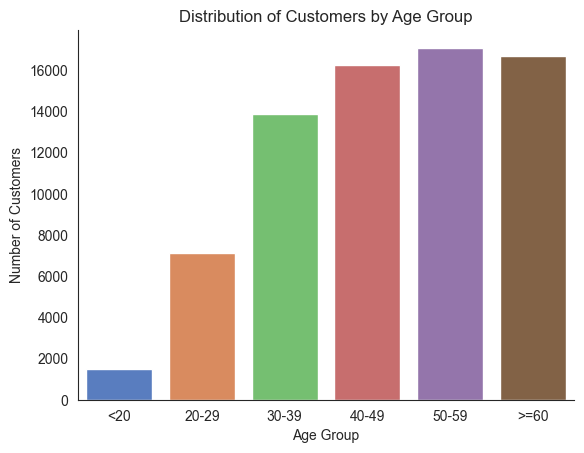

In [91]:
# Group the customers by age group and count the number of customers in each group
age_counts = data_imp.groupby('Age_binned').size()

# Define the new order of age bins
new_order = ['<20', '20-29', '30-39', '40-49', '50-59', '>=60']

# Set Age_binned as the index and reindex the DataFrame based on the new order
age_counts = age_counts.reindex(new_order)

# Create a bar chart of the age counts
sns.barplot(x=age_counts.index, y=age_counts.values, palette='muted')

plt.xlabel('Age Group')
plt.ylabel('Number of Customers')
plt.title('Distribution of Customers by Age Group')

sns.despine()
plt.show()

### Revenue by Age

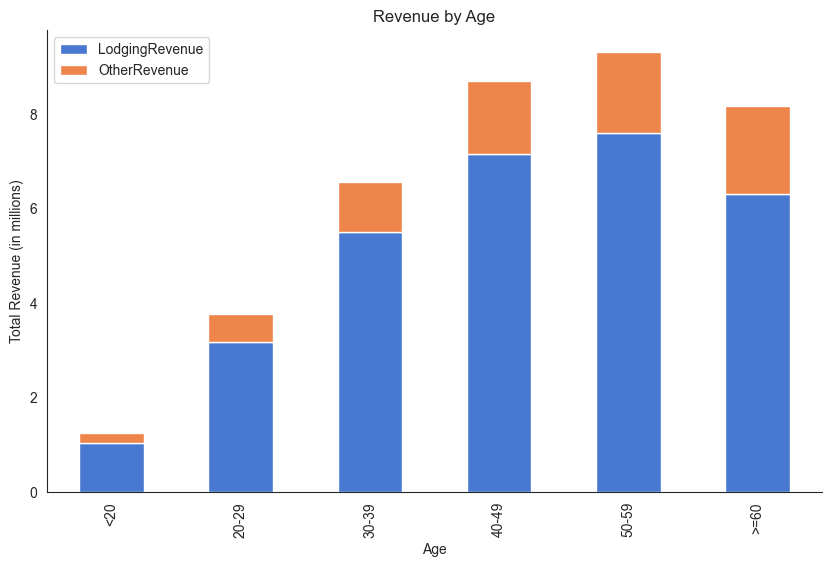

In [92]:
# Group the customers by age group and sum the lodging revenue and other revenue for each group
age_revenue = data_imp.groupby('Age_binned')[['LodgingRevenue', 'OtherRevenue']].sum()

# Define the new order of age bins
new_order = ['<20', '20-29', '30-39', '40-49', '50-59', '>=60']

# Set Age_binned as the index and reindex the DataFrame based on the new order
age_revenue = age_revenue.reindex(new_order)

# Divide the revenue values by 1 million
age_revenue = age_revenue / 1000000

colors = sns.color_palette('muted')

# Create a stacked bar plot
ax = age_revenue.plot(kind='bar', stacked=True, figsize=(10, 6), width=0.5, color=colors)

ax.set_xlabel('Age')
ax.set_ylabel('Total Revenue (in millions)')
ax.set_title('Revenue by Age')

sns.despine()
plt.show()

### Pie Chart of Continents

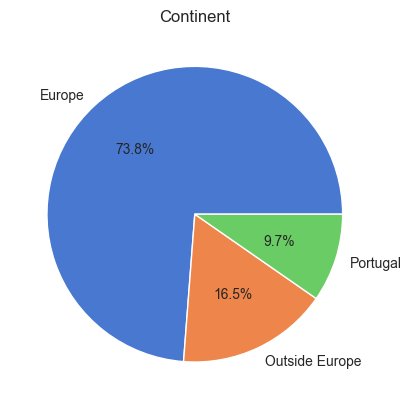

In [93]:
ds_copy = data_imp.copy()

# Calculate the percentage of each nationality
nationality_percentages = ds_copy['Continent'].value_counts(normalize=True)

# Define the new order of age bins
new_names = ['Portugal', 'Europe', 'Outside Europe']

# Set Age_binned as the index and reindex the DataFrame based on the new order
age_revenue = age_revenue.reindex(new_order)

palette = sns.color_palette('muted', n_colors=len(ds_copy['Continent'].unique()))

plt.pie(ds_copy['Continent'].value_counts(), labels=ds_copy['Continent'].value_counts().index, autopct='%1.1f%%', colors=palette)

plt.title('Continent')

plt.show()

### Bookings with CheckedIn by Top Nationalities

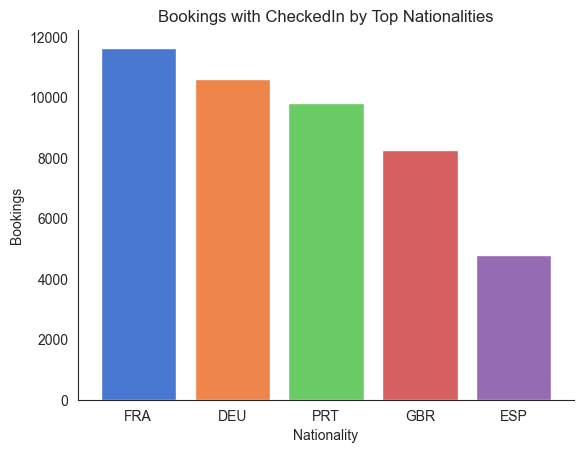

In [94]:
# Group the data by nationality and sum the 'BookingsCheckedIn'
grouped_data = data_imp.groupby('Nationality')[['BookingsCheckedIn']].sum()

# Sort the data by the sum of both variables in descending order
grouped_data = grouped_data.sort_values(by=['BookingsCheckedIn'], ascending=False)

# Get the top 5 countries with the largest sum of both variables
top_countries = data_imp['Nationality'].value_counts().nlargest(5).index

# Filter the data for the top 5 countries
top_countries_data = data_imp.loc[data_imp['Nationality'].isin(top_countries)]

# Group the data by nationality and sum the 'BookingsCanceled' and 'BookingsNoShowed' variables
grouped_data = top_countries_data.groupby('Nationality')[['BookingsCheckedIn']].sum()

# Define the new order of nationalities
new_order = ['FRA', 'DEU', 'PRT', 'GBR', 'ESP']

# Set grouped_data index 
grouped_data = grouped_data.reindex(new_order)

# Create a bar chart of the age counts
plt.bar(grouped_data['BookingsCheckedIn'].index, grouped_data['BookingsCheckedIn'].values, color=sns.color_palette('muted', n_colors=len(new_order)))

plt.xlabel('Nationality')
plt.ylabel('Bookings')
plt.title('Bookings with CheckedIn by Top Nationalities')

sns.despine()
plt.show()

### Bookings canceled and no-shows by top 5 Nationalities

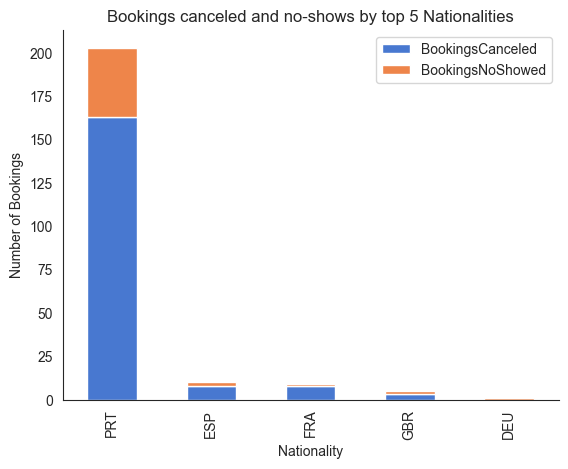

In [95]:
# Group the data by nationality and sum the 'BookingsCanceled' and 'BookingsNoShowed' variables
grouped_data = data_imp.groupby('Nationality')[['BookingsCanceled', 'BookingsNoShowed']].sum()

# Sort the data by the sum of both variables in descending order
grouped_data = grouped_data.sort_values(by=['BookingsCanceled', 'BookingsNoShowed'], ascending=False)

# Get the top 5 countries with the largest sum of both variables
top_countries = data_imp['Nationality'].value_counts().nlargest(5).index

# Filter the data for the top 5 countries
top_countries_data = data_imp.loc[data_imp['Nationality'].isin(top_countries)]

# Group the data by nationality and sum the 'BookingsCanceled' and 'BookingsNoShowed' variables
grouped_data = top_countries_data.groupby('Nationality')[['BookingsCanceled', 'BookingsNoShowed']].sum()

# Define the new order of nationalities
new_order = ['PRT', 'ESP', 'FRA', 'GBR', 'DEU']

# Set grouped_data index 
grouped_data = grouped_data.reindex(new_order)

# Set the color palette
colors = sns.color_palette('muted')

# Create a stacked bar plot
grouped_data.plot(kind='bar', stacked=True, color=colors)

plt.xlabel('Nationality')
plt.ylabel('Number of Bookings')
plt.title('Bookings canceled and no-shows by top 5 Nationalities')

sns.despine()
plt.show()

### Revenue by Top 5 Nationalities

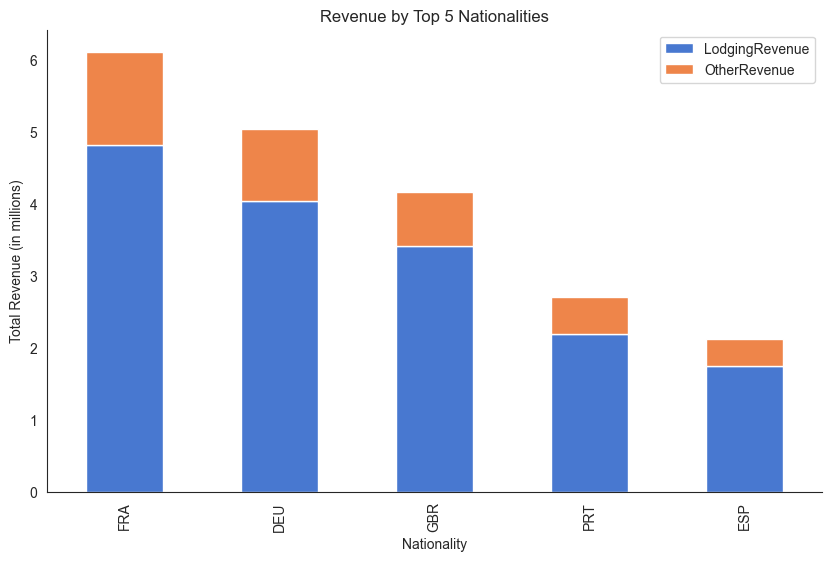

In [96]:
# Get the top 5 nationalities based on count
top_nationalities = data_imp['Nationality'].value_counts().nlargest(5).index

# Filter the data for the top 5 nationalities
filtered_data = data_imp[data_imp['Nationality'].isin(top_nationalities)]

# Group the data by nationality and sum the revenue variables
grouped_data = filtered_data.groupby('Nationality')[['LodgingRevenue', 'OtherRevenue']].sum()

# Define the new order of nationalities
new_order = ['FRA', 'DEU', 'GBR', 'PRT', 'ESP']

# Set grouped_data index 
grouped_data = grouped_data.reindex(new_order)

# Divide the revenue values by 1 million
grouped_data = grouped_data / 1000000

colors = sns.color_palette('muted')

ax = grouped_data.plot(kind='bar', stacked=True, sort_columns=True, figsize=(10, 6), color=colors)

ax.set_xlabel('Nationality')
ax.set_ylabel('Total Revenue (in millions)')
ax.set_title('Revenue by Top 5 Nationalities')

sns.despine()
plt.show()

### Customers by Distribution Channel and Market Segment

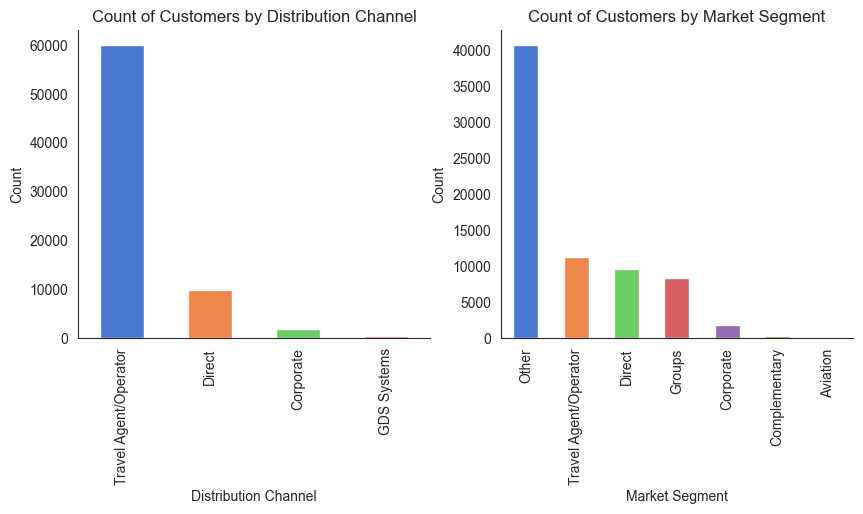

In [97]:
# Create a series with the count of customers from each distribution channel
distribution_channel_counts = data_imp['DistributionChannel'].value_counts()

# Create a series with the count of customers from each market segment
market_segment_counts = data_imp['MarketSegment'].value_counts()

colors = sns.color_palette('muted')

# Create a bar chart 
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
distribution_channel_counts.plot(kind='bar', ax=ax1, color=colors)
market_segment_counts.plot(kind='bar', ax=ax2, color=colors)

ax1.set_title('Count of Customers by Distribution Channel')
ax1.set_xlabel('Distribution Channel')
ax1.set_ylabel('Count')


ax2.set_title('Count of Customers by Market Segment')
ax2.set_xlabel('Market Segment')
ax2.set_ylabel('Count')

sns.despine()
plt.show()

### Top 5 Requested Services

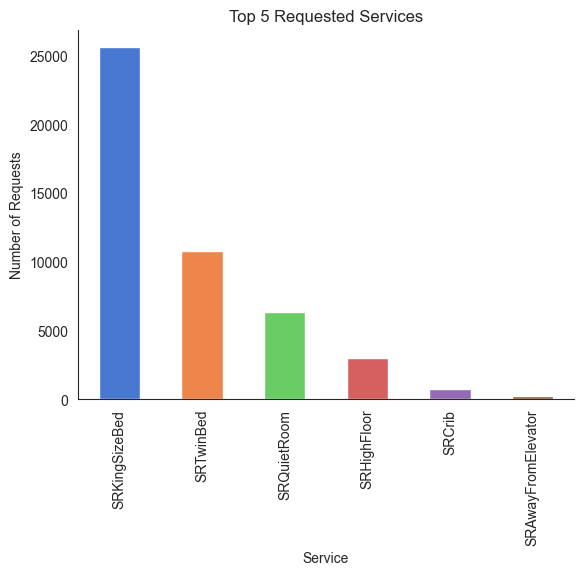

In [98]:
# Count the number of times each service was selected
service_counts = data_imp.loc[:,binary_vars].sum()

# Sort the services by their count and select the top 5
top_services = service_counts.sort_values(ascending=False)[:6]

colors = sns.color_palette('muted')

# Create a bar chart of the top services
ax = top_services.plot(kind='bar', color=colors)

ax.set_title('Top 5 Requested Services')
ax.set_xlabel('Service')
ax.set_ylabel('Number of Requests')

sns.despine()
plt.show()

### Years of registration

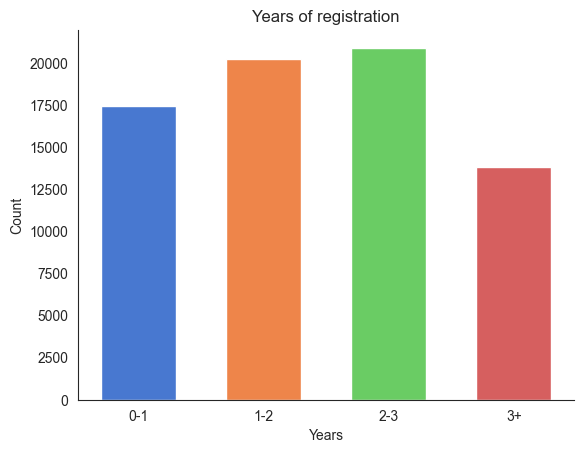

In [99]:
# Create a DataFrame with the binned values and their counts
bins = pd.cut(data_imp['DaysSinceCreation'], bins=[0, 365, 730, 1095, float('inf')], labels=['0-1', '1-2', '2-3', '3+'])
counts = bins.value_counts().sort_index()
df = pd.DataFrame({'DaysSinceCreation_binned': counts.index, 'Count': counts.values})

colors = sns.color_palette('muted')

#Pplot the bar chart with the ordered bins
plt.bar(df['DaysSinceCreation_binned'], df['Count'], width = 0.6, color=colors)
plt.xlabel('Years')
plt.ylabel('Count')

plt.title('Years of registration')

sns.despine()
plt.show()

- Overall we have a fairly older customer base with a large proportion of europeans, around 74%;
- As is usually expected, spending goes up with age and France, Germany, Portugal, Great Britain and Spain are the countries that stand out and also the countries with most Checked In's, as expected;
- Portugal stands out because it's the country with the largest number of Bookings Cancelled and No Show;
- Most customers are aquired through Travael agents/Operators and most market segments are not cleary defined.

In [100]:
ProfileReport(
    data_imp, 
    title='Analysis of our Customers',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": True},
        "kendall": {"calculate": True},
        "phi_k": {"calculate": True},
        "cramers": {"calculate": True},
    },
)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

####  Analysis of the features

- Our customers have a mean age of around 48 years, with the most significant group being 50-59 (although are all very similar until ages below 29). 
- The most used distribution channel is by far travel agents/operators, with Corporate around 3% and GDS Systems with only 0.8%. - The creation of the profiles is fairly spread out over time around 0 and 3.8 years. 
- Around 83% of our clients are from Europe, with most of our clients being from France (16%), Germany (14%), Great Britain (11%), Portugal (10%) and Spain (6%). 
- Our clients tend to make reservations closer to the arrival date, with the most frequent values of lead time close to 0. The values go from 0 to a bit over 1 year and a half. 
- On average, a client brings 437 euros of lodging revenues and 100 of other revenues. 
- Our worst customers (worst 25%) bring between 0 and 202 euros of lodging revenues while our best bring between 504 and 24122.95. In terms of other revenues, our worst customers bring between 0 and 28 euros and our best bring between 118.5 and 8859.25. 
- When it comes to bookings, 95% of the clients have only checked-in once, around 99.99% have never canceled and more than 99.99% have never made a no-show.

In [101]:
# Removing the variables that were transformed
data_imp.drop(columns=['Nationality','Age','DaysSinceCreation','AverageLeadTime','LodgingRevenue','OtherRevenue',
'DistributionChannel','BookingsCheckedIn','BookingsCanceled','BookingsNoShowed','Age_binned','LodgingRevenue_binned',
'OtherRevenue_binned','DaysSinceCreation_binned','AverageLeadTime_binned','BookingsCheckedIn_binned','BookingsCanceled_binned',
'BookingsNoShowed_binned','TotalRevenue_binned'],inplace=True)

In [102]:
# Removing this variable as it was created for the analysis of the customers
data_imp.drop('Continent',axis=1,inplace=True)

In [103]:
to_remove = ['Nationality','DistributionChannel','Age_binned','LodgingRevenue_binned','OtherRevenue_binned',
'DaysSinceCreation_binned','AverageLeadTime_binned','BookingsCheckedIn_binned','BookingsCanceled_binned',
'BookingsNoShowed_binned','TotalRevenue_binned']
non_metric_features= [i for i in non_metric_features if i not in to_remove]

In [104]:
to_remove = ['Age','DaysSinceCreation','AverageLeadTime','LodgingRevenue','OtherRevenue','BookingsCheckedIn',
'BookingsCanceled','BookingsNoShowed','TotalRevenue']
metric_features= [i for i in metric_features if i not in to_remove]

<a class="anchor" id="selection">
    
## 3.5. Feature Selection
    
    
</a>

In [105]:
# These do not add any relevant information to the modelling
data_imp.drop(['NameHash','DocIDHash'],axis=1,inplace=True)

In [106]:
# We decided to remove these variables because of the extreme imbalance between 0's and 1's, their lack of value for accurately 
#segmenting the customers and their lack of correlation with any other variables
data_imp.drop(['SRLowFloor','SRAccessibleRoom','SRMediumFloor','SRBathtub','SRShower','SRNearElevator','SRAwayFromElevator'
               ,'SRNoAlcoholInMiniBar'],axis=1,inplace=True)

In [107]:
# We are creating a new segment because the previous segmenting strategy was not adequate.
# Therefore, we should not maintain this variable here considering also that 
#we would have to segment the new customers according to it
data_imp.drop(['MarketSegment'],axis=1,inplace=True)

In [108]:
# We have decided to remove these variables because of their lack of value for accurately segmenting the customers and their
# strong correlations to some of the existing variables
data_imp.drop(['TotalRevenue','AverageRevenueBooking','AverageRoomNights', 'AveragePersonsNights', 'RatioPersonsPerRoom',
'CancellationRatio', 'AverageRoomRate'],axis=1,inplace=True)

In [109]:
to_remove = ['TotalRevenue','AverageRevenueBooking','AverageRoomNights', 'AveragePersonsNights', 'RatioPersonsPerRoom',
'CancellationRatio', 'AverageRoomRate']
metric_features= [i for i in metric_features if i not in to_remove]

In [110]:
to_remove = ['MarketSegment','SRLowFloor','SRAccessibleRoom','SRMediumFloor','SRBathtub','SRShower','SRNearElevator',
'SRAwayFromElevator','SRNoAlcoholInMiniBar','NameHash','DocIDHash']
non_metric_features= [i for i in non_metric_features if i not in to_remove]

In [111]:
ProfileReport(
    data_imp, 
    title='Redundancy',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": True},
        "kendall": {"calculate": True},
        "phi_k": {"calculate": True},
        "cramers": {"calculate": True},
    },
)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

####  Analysis of the correlations

- `LodgingRevenue>Q3` is highly correlated to `RoomNights` as expected
- `PersonsNights` is highly correlated to `RoomNights` which is expected as well, but we keep both, considering their value for segmenting the customers and the fact we are using PCA (takes care of the correlations).

<a class="anchor" id="export">
    
## 3.8. Export
    
    
</a>

In [112]:
data_imp.to_csv("data_new.csv")